<a href="https://colab.research.google.com/github/mohammadsanaee/ML_in_application/blob/main/3_decision_trees_random_forest.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Handle text data
In this lesson, we will work with [the 20 newsgroups text dataset](https://scikit-learn.org/0.19/datasets/twenty_newsgroups.html).
It contains about 18000 posts on 20 news topics.
We will choose only scientific topics and solve the following classification problem: separate posts about space from all the other posts.

In [1]:
from sklearn.datasets import fetch_20newsgroups

categories = ('sci.crypt', 'sci.electronics', 'sci.med', 'sci.space')
remove = ('headers', 'footers', 'quotes')
newsgroups_train = fetch_20newsgroups(subset='train', remove=remove, categories=categories)
newsgroups_test = fetch_20newsgroups(subset='test', remove=remove, categories=categories)

print("Data:\n", newsgroups_train.data[31])
print("---")
print("Target:", newsgroups_train.target[31])

Data:
 I've got two lines coming into my apartment. Two different telephone numbers.
When I ordered the second line installed, instead of bringing out another 4
wire bundle, the telco just connected up to my yellow and black wires. So I
have one line on red & green and the other on yellow & black.

Today I was monitoring the voltage on both lines. I had a voltmeter across
the red and green and read back 52 volts. I then lifted up the receiver on my
second line.(black & yellow wires) The voltage dropped to 31 volts on the first
line. (red & green wires) I repeated this experiment with the second
line(monitoring black & yellow and lifting the handset off the cradle on the
red and green line.) It also dropped to 31 volts. 

Why is this ? I thought these were separate lines.

Next I went to the 66 block and disconnected the blue and white lines coming in
from the telco cable. I then disconnected all the phones in my apartment and
went back to the 66 block and did some resistance measuremen

There are some common steps to be performed while working with text data:
- convert to lowercase,
- strip punctuation,
- split into words,
and so on.

Also, we need to convert a text into a numeric feature vector.
To do that, we will use so-called *one-hot* encoding.
We will create a large boolean feature vector, where each component of the vector corresponds to some particular word: if the word is present in the input text, this component is equal to 1, otherwise it is equal to 0.

`sklearn.feature_extraction.text.HashingVectorizer` does exactly this, but it doesn't store the vocabulary (we will need the vocabulary for visualization).

Therefore, for feature extraction we will use `sklearn.feature_extraction.text.CountVectorizer` + `np.clip()`

In [2]:
from sklearn.feature_extraction.text import CountVectorizer

# the texts we will vectorize
data = [
  "One, two, three.",
  "Two, three.",
  "Three, three."
]

vec = CountVectorizer()

# use the method `.fit()` to learn the vocabulary
vec.fit(data)


CountVectorizer()

In [3]:
# vocabulary maps word into its index in feature vector
# note the words are lowercased, punctuation is ignored
vec.vocabulary_

{'one': 0, 'two': 2, 'three': 1}

In [4]:
# transform the initial dataset
vec.transform(data).todense()

matrix([[1, 1, 1],
        [0, 1, 1],
        [0, 2, 0]])

In [5]:
# transform new data with unknown words
# note that new words are ignored
new_data = [
    "Two, three, three, four",
    "Five",
]
vec.transform(new_data).todense()

matrix([[0, 2, 1],
        [0, 0, 0]])

In [6]:
# use .clip(0, 1) to get one-hot encoding
import numpy as np

np.clip(vec.transform(data).todense(), 0, 1)

matrix([[1, 1, 1],
        [0, 1, 1],
        [0, 1, 0]])

# Decision Trees
Let's apply one-hot encoding and train the `sklearn.tree.DecisionTreeClassifier`.
We will use *accuracy score* for evaluation.
Accuracy is the fraction of correctly classified examples.

In [7]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
from sklearn.feature_extraction.text import CountVectorizer

vectorizer = CountVectorizer()
vectorizer.fit(newsgroups_train.data)

X_train = vectorizer.transform(newsgroups_train.data)
X_train[X_train.nonzero()] = 1  # the same as clip(X_train, 0, 1) for sparse matrices
y_train = newsgroups_train.target < 3  # 3 is space
X_test = vectorizer.transform(newsgroups_test.data)
X_test[X_test.nonzero()] = 1
y_test = newsgroups_test.target < 3
print(X_train.shape, X_test.shape)

clf = DecisionTreeClassifier(criterion='entropy')
clf.fit(X_train, y_train)
print("Accuracy on the training dataset: {}".format(accuracy_score(clf.predict(X_train), y_train)))
print("Accuracy on the testing dataset: {}".format(accuracy_score(clf.predict(X_test), y_test)))

(2373, 31795) (1579, 31795)
Accuracy on the training dataset: 0.9932574799831437
Accuracy on the testing dataset: 0.8416719442685244


We have nearly optimal performance on the training set, and the test performance is much worse.
This is definitely overfitting.
Let us visualize the learned tree.

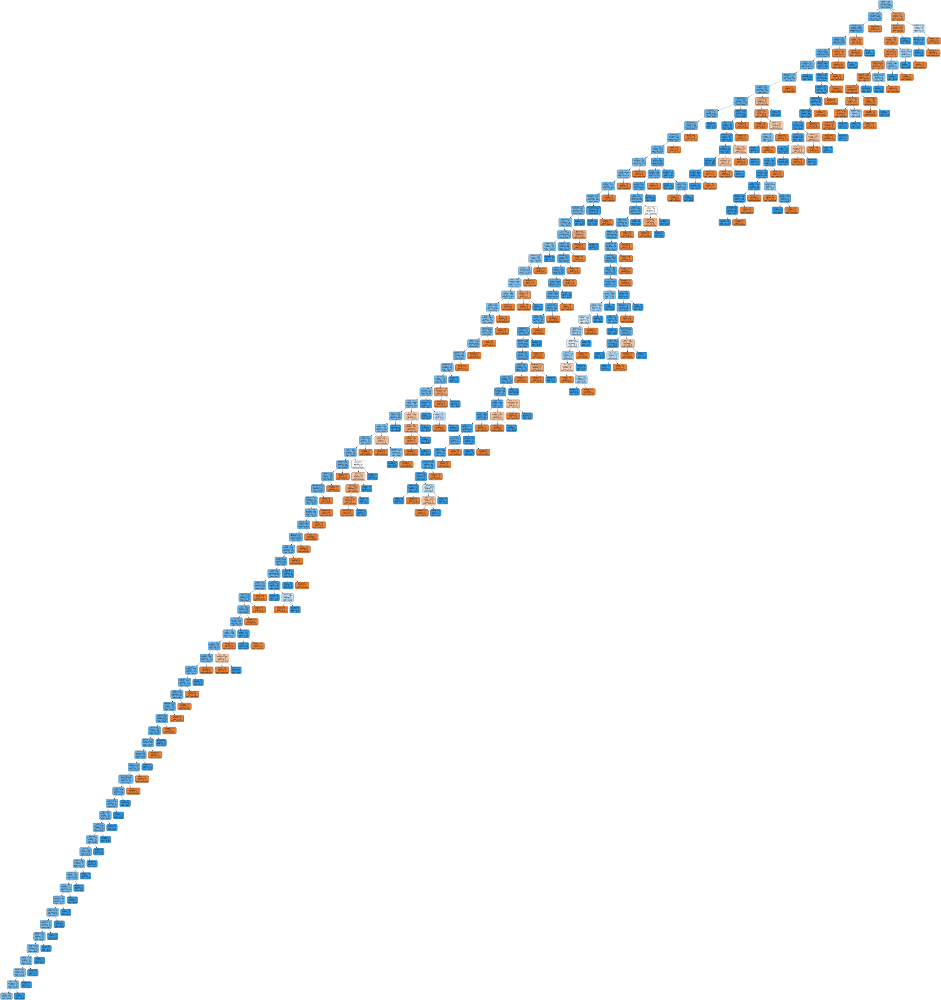

In [8]:
import graphviz
from sklearn.tree import export_graphviz

feature_names = sorted(vectorizer.vocabulary_.keys(), key=lambda w: vectorizer.vocabulary_[w])
dot_data = export_graphviz(
    clf,
    out_file=None,
    feature_names=feature_names,
    filled=True,
    rounded=True,
    class_names=['electronics', 'space']
)
graph = graphviz.Source(dot_data) 
graph

This tree is REALLY huge.
It tries to capture every detail of the training set.
But it is also a good sign: at least, this model is capable to do that.

## Tune hyperparameters of decision trees

Important hyperparameters:

Hyperparameter | Description
--- | ---
max_depth | The maximum depth of the tree. If None, then nodes are expanded until all leaves are pure or until all leaves contain less than min_samples_split samples.
min_samples_split | The minimum number of samples required to split an internal node.
min_samples_leaf | The minimum number of samples required to be at a leaf node.

In [9]:
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint

params_distributions = {
    'max_depth': randint(2, 30),
    'min_samples_split': randint(2, 10),
    'min_samples_leaf': randint(1, 10),
}

clf = RandomizedSearchCV(
    DecisionTreeClassifier(criterion='entropy'),
    params_distributions,
    n_iter=50,
    cv=3,
    random_state=0,
)
clf.fit(X_train, y_train)
clf.best_params_

{'max_depth': 9, 'min_samples_leaf': 8, 'min_samples_split': 8}

In [10]:
print("Accuracy on the training dataset: {}".format(accuracy_score(clf.predict(X_train), y_train)))
print("Accuracy on the testing dataset: {}".format(accuracy_score(clf.predict(X_test), y_test)))

Accuracy on the training dataset: 0.8786346396965866
Accuracy on the testing dataset: 0.8625712476250792


# Random Forest

Let's go back to California Housing Dataset

In [11]:
import pandas as pd
import numpy as np
from sklearn.utils import shuffle

# read the data
df = pd.read_csv('https://raw.githubusercontent.com/horoshenkih/harbour-space-ds210/master/datasets/california_housing_prices.csv')

# add one-hot encoded categories
dfd = pd.get_dummies(df['ocean_proximity'])
df = pd.concat([df, dfd], axis=1)

# fix missing values
df['total_bedrooms'] = df['total_bedrooms'].fillna(df['total_bedrooms'].mean())

df.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,<1H OCEAN,INLAND,ISLAND,NEAR BAY,NEAR OCEAN
count,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,-119.569704,35.631861,28.639486,2635.763081,537.870553,1425.476744,499.539680,3.870671,206855.816909,0.442636,0.317393,0.000242,0.110950,0.128779
std,2.003532,2.135952,12.585558,2181.615252,419.266592,1132.462122,382.329753,1.899822,115395.615874,0.496710,0.465473,0.015563,0.314077,0.334963
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,-121.800000,33.930000,18.000000,1447.750000,297.000000,787.000000,280.000000,2.563400,119600.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,-118.490000,34.260000,29.000000,2127.000000,438.000000,1166.000000,409.000000,3.534800,179700.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,-118.010000,37.710000,37.000000,3148.000000,643.250000,1725.000000,605.000000,4.743250,264725.000000,1.000000,1.000000,0.000000,0.000000,0.000000
max,-114.310000,41.950000,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [12]:
from sklearn.model_selection import train_test_split

X_columns = list(df.columns)
X_columns.remove('median_house_value')
X_columns.remove('ocean_proximity')

X = df[X_columns].to_numpy()
y = df.median_house_value.to_numpy()

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)
print("X_train has shape", X_train.shape)
print("X_test has shape", X_test.shape)
print("y_train has shape", y_train.shape)
print("y_test has shape", y_test.shape)

X_train has shape (13828, 13)
X_test has shape (6812, 13)
y_train has shape (13828,)
y_test has shape (6812,)


Random Forest is implemented in `sklearn.ensemble.RandomForestRegressor`.

Important hyperparameters:

Hyperparameter | Description
--- | ---
n_estimators | The number of trees in the forest. **The more - the better**.
max_features | The number of features to consider when looking for the best split. **The most serious parameter, tune it first!**
max_depth | The same as for DecisionTree.  **Default values are good.**
min_samples_split | The same as for DecisionTree.  **Default values are good.**
min_samples_leaf | The same as for DecisionTree.  **Default values are good.**

In [13]:
from sklearn.ensemble import RandomForestRegressor

from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint

params_distributions = {
    'max_features': randint(1, X_train.shape[1]),  # try the full range
}

clf = RandomizedSearchCV(
    RandomForestRegressor(n_estimators=100, random_state=0),
    params_distributions,
    n_iter=10,
    cv=3,
    random_state=0,
)
clf.fit(X_train, y_train)
clf.best_params_

{'max_features': 6}

In [14]:
def print_training_report(clf, X_train, y_train, X_test, y_test):
    from sklearn.metrics import mean_squared_error
    import numpy as np
    pred_y_train = clf.predict(X_train)
    pred_y_test = clf.predict(X_test)
    train_rmse = np.sqrt(mean_squared_error(y_train, pred_y_train))
    test_rmse = np.sqrt(mean_squared_error(y_test, pred_y_test))

    print("RMSE on train data: {} (relative error {:.1f}%)".format(train_rmse, 100 * train_rmse / np.mean(y_train)))
    print("RMSE on test data: {} (relative error {:.1f}%)".format(test_rmse, 100 * test_rmse / np.mean(y_train)))

# with CatBoost we achieved relative error 22.6%
print_training_report(clf, X_train, y_train, X_test, y_test)

RMSE on train data: 18378.986117430595 (relative error 8.9%)
RMSE on test data: 48991.47505693961 (relative error 23.7%)


How good are individual trees?

average train RMSE of individual estimators: 45148.52699805666
average test RMSE of individual estimators: 75148.42414784405


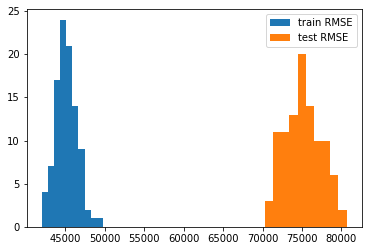

In [15]:
from sklearn.metrics import mean_squared_error

trees_train_rmse = []
trees_test_rmse = []

for tree in clf.best_estimator_.estimators_:
  trees_train_rmse.append(np.sqrt(mean_squared_error(y_train, tree.predict(X_train))))
  trees_test_rmse.append(np.sqrt(mean_squared_error(y_test, tree.predict(X_test))))

print("average train RMSE of individual estimators:", np.mean(trees_train_rmse))
print("average test RMSE of individual estimators:", np.mean(trees_test_rmse))

import matplotlib.pyplot as plt
plt.hist(trees_train_rmse, label='train RMSE')
plt.hist(trees_test_rmse, label='test RMSE')
plt.legend()
plt.show()

We see that individual trees overfit a lot, since the maximum depth is not restricted.

## Feature importances
Feature importances are stored in the attribute `feature_importances_`.

The higher, the more important the feature. The importance of a feature is computed as the (normalized) total reduction of the criterion brought by that feature. It is also known as the Gini importance.

In [16]:
named_feature_importances = {f: imp for f, imp in zip(X_columns, clf.best_estimator_.feature_importances_)}
for f in sorted(named_feature_importances.keys(), key=lambda x: -named_feature_importances[x]):
  print("{}\t{:.3f}".format(f, named_feature_importances[f]))

median_income	0.426
INLAND	0.145
longitude	0.112
latitude	0.100
housing_median_age	0.048
population	0.045
total_rooms	0.035
total_bedrooms	0.032
households	0.028
<1H OCEAN	0.018
NEAR OCEAN	0.008
NEAR BAY	0.003
ISLAND	0.000


In [17]:
import graphviz
from sklearn.tree import export_graphviz

feature_names = X_columns
dot_data = export_graphviz(
    clf.best_estimator_.estimators_[0],
    out_file=None,
    feature_names=feature_names,
    filled=True,
    rounded=True,
    class_names=['electronics', 'space']
)
graph = graphviz.Source(dot_data) 
graph

# Extremely Randomized Trees (ExtRa Trees)

This is a variation of ensemble of trees.
Differences from Random Forest:
- No bootstrap (the whole dataset is used)
- Uses random splits for features.

Advantage: faster than Random Forest.

Disadvantage: works worse than RF with many noisy features.

In [18]:
from sklearn.ensemble import ExtraTreesRegressor

clf = ExtraTreesRegressor(n_estimators=100, random_state=0)
clf.fit(X_train, y_train)
print_training_report(clf, X_train, y_train, X_test, y_test)

RMSE on train data: 2.286564498471376 (relative error 0.0%)
RMSE on test data: 52540.69193262118 (relative error 25.4%)


# Outliers detection with Random Forest

Read more about outliers detection [here](https://scikit-learn.org/stable/modules/outlier_detection.html).

Many applications require being able to decide whether a new observation belongs to the same distribution as existing observations (it is an inlier), or should be considered as different (it is an outlier). Often, this ability is used to clean real data sets. Two important distinctions must be made:

- outlier detection:

  The training data contains outliers which are defined as observations that are far from the others. Outlier detection estimators thus try to fit the regions where the training data is the most concentrated, ignoring the deviant observations.

- novelty detection:
  
  The training data is not polluted by outliers and we are interested in detecting whether a new observation is an outlier. In this context an outlier is also called a novelty.

Outlier detection and novelty detection are both used for anomaly detection, where one is interested in detecting abnormal or unusual observations. Outlier detection is then also known as unsupervised anomaly detection and novelty detection as semi-supervised anomaly detection. In the context of outlier detection, the outliers/anomalies cannot form a dense cluster as available estimators assume that the outliers/anomalies are located in low density regions. On the contrary, in the context of novelty detection, novelties/anomalies can form a dense cluster as long as they are in a low density region of the training data, considered as normal in this context.

## Isolation forest
One efficient way of performing outlier detection in high-dimensional datasets is to use random forests. The `ensemble.IsolationForest` ‘isolates’ observations by randomly selecting a feature and then randomly selecting a split value between the maximum and minimum values of the selected feature.

Since recursive partitioning can be represented by a tree structure, the number of splittings required to isolate a sample is equivalent to the path length from the root node to the terminating node.

This path length, averaged over a forest of such random trees, is a measure of normality and our decision function.

Random partitioning produces noticeably shorter paths for anomalies. Hence, when a forest of random trees collectively produce shorter path lengths for particular samples, they are highly likely to be anomalies.

The implementation of `ensemble.IsolationForest` is based on an ensemble of `tree.ExtraTreeRegressor`.


In [19]:
# we need python3.8
!pip install kora
import kora.install.py38

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.7/57.7 KB 5.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 34.3 MB/s eta 0:00:00
https://9d58-34-125-155-47.ngrok.io


In [20]:
!pip uninstall scikit-learn -y
!pip install scikit-learn
!pip list | grep scikit-learn

Found existing installation: scikit-learn 1.0.2
Uninstalling scikit-learn-1.0.2:
  Successfully uninstalled scikit-learn-1.0.2
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.7/9.7 MB 71.7 MB/s eta 0:00:00


scikit-learn                  1.2.0


In [21]:
import sklearn
sklearn.__version__

'1.0.2'

## Demo of IsolationForest
We generate two clusters (each one containing n_samples) by randomly sampling the standard normal distribution. One of them is spherical and the other one is slightly deformed.

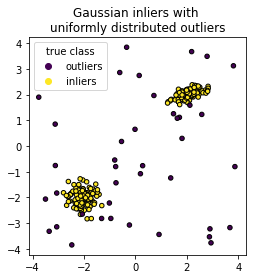

In [22]:
import numpy as np
from sklearn.model_selection import train_test_split

n_samples, n_outliers = 120, 40
rng = np.random.RandomState(0)
covariance = np.array([[0.5, -0.1], [0.7, 0.4]])
cluster_1 = 0.4 * rng.randn(n_samples, 2) @ covariance + np.array([2, 2])  # general
cluster_2 = 0.3 * rng.randn(n_samples, 2) + np.array([-2, -2])  # spherical
outliers = rng.uniform(low=-4, high=4, size=(n_outliers, 2))

X = np.concatenate([cluster_1, cluster_2, outliers])
y = np.concatenate(
    [np.ones((2 * n_samples), dtype=int), -np.ones((n_outliers), dtype=int)]
)

X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, random_state=42)

import matplotlib.pyplot as plt

scatter = plt.scatter(X[:, 0], X[:, 1], c=y, s=20, edgecolor="k")
handles, labels = scatter.legend_elements()
plt.axis("square")
plt.legend(handles=handles, labels=["outliers", "inliers"], title="true class")
plt.title("Gaussian inliers with \nuniformly distributed outliers")
plt.show()

Train the model

In [23]:
from sklearn.ensemble import IsolationForest

clf = IsolationForest(max_samples=100, random_state=0)
clf.fit(X_train)

IsolationForest(max_samples=100, random_state=0)

We use the class DecisionBoundaryDisplay to visualize a discrete decision boundary. The background color represents whether a sample in that given area is predicted to be an outlier or not. The scatter plot displays the true labels.

The measure of "normality" of an observation is given by the path length averaged over a forest of random trees, which itself is given by the depth of the leaf (or equivalently the number of splits) required to isolate a given sample.

*When a forest of random trees collectively produce short path lengths for isolating some particular samples, they are highly likely to be anomalies and the measure of normality is close to 0. Similarly, large paths correspond to values close to 1 and are more likely to be inliers.*

In [24]:
import matplotlib.pyplot as plt
from sklearn.inspection import DecisionBoundaryDisplay
disp = DecisionBoundaryDisplay.from_estimator(
    clf,
    X,
    response_method="predict",
    alpha=0.5,
)
disp.ax_.scatter(X[:, 0], X[:, 1], c=y, s=20, edgecolor="k")
disp.ax_.set_title("Binary decision boundary \nof IsolationForest")
plt.axis("square")
plt.legend(handles=handles, labels=["outliers", "inliers"], title="true class")

plt.show()

ImportError: ignored

In [ ]:
disp = DecisionBoundaryDisplay.from_estimator(
    clf,
    X,
    response_method="decision_function",
    alpha=0.5,
)
disp.ax_.scatter(X[:, 0], X[:, 1], c=y, s=20, edgecolor="k")
disp.ax_.set_title("Path length decision boundary \nof IsolationForest")
plt.axis("square")
plt.legend(handles=handles, labels=["outliers", "inliers"], title="true class")
plt.colorbar(disp.ax_.collections[1])
plt.show()

# Home Assignment

## Exercise 1 (2 points)

Tune hyperparameters max_depth, max_samples_split, max_samples_leaf of RandomForestRegressor.

In [44]:
from sklearn.ensemble import RandomForestRegressor

from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint
from random import random

params_distributions = {
    'max_depth': randint(1, 100),
    'min_samples_split':randint(2, 10),
    'min_samples_leaf':randint(2, 10),
    'max_features': randint(1, X_train.shape[1]), 
}

clf = RandomizedSearchCV(
    RandomForestRegressor(n_estimators=100, random_state=0),
    params_distributions,
    n_iter=10,
    cv=3,
    random_state=0,
    error_score='raise',
    
)
clf.fit(X_train, y_train)
print_training_report(clf, X_train, y_train, X_test, y_test)
clf.best_params_

RMSE on train data: 0.14959307196962673 (relative error 20.9%)
RMSE on test data: 0.3898124539262998 (relative error 54.6%)


{'max_depth': 89,
 'max_features': 1,
 'min_samples_leaf': 2,
 'min_samples_split': 6}

## Exercise 2 (2 points)

Compare Random Forest models with and without bootstrap (hyperparameter `bootstrap=True/False`). Choose best hyperparameters for each model. Does bootstrap improve quality on the California Housing Dataset?

In [47]:
params_distributions = {
    'bootstrap': [True,False],
    'max_depth': randint(1, 100),
    'min_samples_split':randint(2, 10),
    'min_samples_leaf':randint(2, 10),
    'max_features': randint(1, X_train.shape[1]), 
}

clf = RandomizedSearchCV(
    RandomForestRegressor(n_estimators=100, random_state=0),
    params_distributions,
    n_iter=10,
    cv=3,
    random_state=0,
    error_score='raise',
    
)
clf.fit(X_train, y_train)
print_training_report(clf, X_train, y_train, X_test, y_test)
clf.best_params_

RMSE on train data: 0.09620579793107874 (relative error 13.5%)
RMSE on test data: 0.37496179699583954 (relative error 52.5%)


{'bootstrap': False,
 'max_depth': 71,
 'max_features': 1,
 'min_samples_leaf': 2,
 'min_samples_split': 2}

**As the best value for Bootstrap is Flase so bootstrp does not improve the model**

## Exercise 3 (2 points)
Apply `RandomForestClassifier` on the dataset from the demonstration of Decision Trees (20newsgroup, classify space vs other science). Choose optimal hyperparameter. Use CountVectorizer to extract features.

In [56]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.feature_extraction.text import CountVectorizer

vectorizer = CountVectorizer()
vectorizer.fit(newsgroups_train.data)

X_train = vectorizer.transform(newsgroups_train.data)
X_train[X_train.nonzero()] = 1  
y_train = newsgroups_train.target < 3  
X_test = vectorizer.transform(newsgroups_test.data)
X_test[X_test.nonzero()] = 1
y_test = newsgroups_test.target < 3



(2373, 31795) (1579, 31795)
Accuracy on the training dataset: 0.9928360724820902
Accuracy on the testing dataset: 0.8480050664977834


In [60]:

params_distributions = {
    'criterion':['gini', 'entropy'],
    'max_depth': randint(1, 200),
    'min_samples_split':randint(2, 10),
    'min_samples_leaf':randint(2, 10),
    'max_features': randint(1, X_train.shape[1]), 
}
clf = RandomizedSearchCV(
    RandomForestClassifier(),
    params_distributions,
    cv=5,
    random_state=0,   
    error_score='raise', 
)
clf.fit(X_train, y_train)
print("Accuracy on the training dataset: {}".format(accuracy_score(clf.predict(X_train), y_train)))
print("Accuracy on the testing dataset: {}".format(accuracy_score(clf.predict(X_test), y_test)))
clf.best_params_

Accuracy on the training dataset: 0.9679730299199326
Accuracy on the testing dataset: 0.8872704243191893


{'criterion': 'gini',
 'max_depth': 80,
 'max_features': 7600,
 'min_samples_leaf': 2,
 'min_samples_split': 4}